<a href="https://colab.research.google.com/github/PJ40200/Object-Detection-for-Visual-Impairment-Support/blob/main/Detectron2_Currency_Model_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installing and importing all the requirements

In [ ]:
!pip install pyyaml==5.1
!pip install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu118  # Use --extra-index-url

# Install Detectron2
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu118/torch2.0/index.html

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44091 sha256=a6cc17ae8a9403534c77d1e8c119bf33b4d5fea218b5a6660e67b9fd961cad0e
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0.2
    Uninstalling PyYAML-6.0.2:
      Successfully uninstalled PyYAML-6.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flax 0.8.4 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu118
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu118/torch2.0/index.htm

In [ ]:
# Install dependencies
!pip install pyyaml==5.1
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

# Install Detectron2
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu118/torch2.0/index.html

Looking in indexes: https://download.pytorch.org/whl/cu118
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu118/torch2.0/index.html
ERROR: Could not find a version that satisfies the requirement detectron2 (from versions: none)
ERROR: No matching distribution found for detectron2


In [ ]:
import sys, os, distutils.core

!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

Cloning into 'detectron2'...
remote: Enumerating objects: 15773, done.
remote: Counting objects: 100% (30/30), done.
remote: Compressing objects: 100% (26/26), done.
remote: Total 15773 (delta 6), reused 27 (delta 4), pack-reused 15743 (from 1)
Receiving objects: 100% (15773/15773), 6.35 MiB | 18.78 MiB/s, done.
Resolving deltas: 100% (11500/11500), done.
Ignoring dataclasses: markers 'python_version < "3.7"' don't match your environment
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 682.4 kB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.2/78.2 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached pathspec-0.12.1-py3-none-any.whl.metadata (21 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 427.8/427.8 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.2 MB/s eta 0:00:00
   ━━━━━━

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

/bin/bash: line 1: nvcc: command not found
torch:  2.4 ; cuda:  cpu
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Downloading and preparing the data

In [ ]:
# downloading the dataset from roboflow
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="4vCOYAvx9Pys1mwG6ULP")
project = rf.workspace("abhishek-nishad").project("currency-note-detection-hmfqa")
version = project.version(2)
dataset = version.download("coco")

  Using cached PyYAML-6.0.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (2.1 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 kB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 23.4 MB/s eta 0:00:00
Using cached PyYAML-6.0.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (751 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 2.8 MB/s eta 0:00:00
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 5.1
    Uninstalling PyYAML-5.1:
      Successfully uninstalled PyYAML-5.1
  Attempting uninstall: idna
    Found existing installation: idna 3.8
    Uninstalling idna-3.8:
      Successfully uninstalled idna-3.8


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Currency-Note-Detection-2 in coco:: 100%|██████████| 446/446 [00:00<00:00, 4310.97it/s]


In [ ]:
from pycocotools import mask as maskUtils
import numpy as np

def bbox_to_polygon(bbox):
    x, y, w, h = bbox
    return [[x, y, x + w, y, x + w, y + h, x, y + h]]

# function to convert the COCO annotations
def add_segmentation_to_coco(coco_annotation_file):
    with open(coco_annotation_file, 'r') as f:
        coco_data = json.load(f)

    for annotation in coco_data['annotations']:
        if 'segmentation' not in annotation or not annotation['segmentation']:
            bbox = annotation['bbox']
            annotation['segmentation'] = bbox_to_polygon(bbox)

    with open(coco_annotation_file, 'w') as f:
        json.dump(coco_data, f)

# Call this function on your annotation file
add_segmentation_to_coco('/content/Currency-Note-Detection-2/train/_annotations.coco.json')
add_segmentation_to_coco('/content/Currency-Note-Detection-2/valid/_annotations.coco.json')
add_segmentation_to_coco('/content/Currency-Note-Detection-2/test/_annotations.coco.json')

In [ ]:
#/ registering the dataset
from detectron2.data.datasets import register_coco_instances
register_coco_instances("Currency_train", {}, "/content/Currency-Note-Detection-2/train/_annotations.coco.json", "/content/Currency-Note-Detection-2/train")
register_coco_instances("Currency_test", {}, "/content/Currency-Note-Detection-2/test/_annotations.coco.json", "/content/Currency-Note-Detection-2/test")
register_coco_instances("Currency_valid", {}, "/content/Currency-Note-Detection-2/valid/_annotations.coco.json", "/content/Currency-Note-Detection-2/valid")

In [ ]:
MetadataCatalog.get("Currency_train")

namespace(name='Currency_train',
          json_file='/content/Currency-Note-Detection-2/train/_annotations.coco.json',
          image_root='/content/Currency-Note-Detection-2/train',
          evaluator_type='coco')

In [ ]:
# checking the category ids
from pycocotools.coco import COCO

# Load the COCO annotations file
coco = COCO("/content/Currency-Note-Detection-2/train/_annotations.coco.json")

# Get all categories
categories = coco.loadCats(coco.getCatIds())

# Extract category_ids and category names
category_ids = [category['id'] for category in categories]
category_names = [category['name'] for category in categories]

# Print category_ids and their corresponding names
for category_id, category_name in zip(category_ids, category_names):
    print(f"Category ID: {category_id}, Name: {category_name}")


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Category ID: 0, Name: Currency-Notes
Category ID: 1, Name: Rs_1
Category ID: 2, Name: Rs_10
Category ID: 3, Name: Rs_100
Category ID: 4, Name: Rs_2
Category ID: 5, Name: Rs_20
Category ID: 6, Name: Rs_200
Category ID: 7, Name: Rs_2000
Category ID: 8, Name: Rs_5
Category ID: 9, Name: Rs_50
Category ID: 10, Name: Rs_500
Category ID: 11, Name: coin_1
Category ID: 12, Name: coin_10
Category ID: 13, Name: coin_2
Category ID: 14, Name: coin_20
Category ID: 15, Name: coin_5
Category ID: 16, Name: coin_50_paise


# Training the data on the loaded dataset

In [ ]:
# hellooo world
# saveeeee hooo jaaaa
# 780!!!!! -> last iterationnnnnnnn yayyy

In [ ]:
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer

# Initialize config
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("Currency_train",)
cfg.DATASETS.TEST = ()   # or just ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Use pre-trained weights
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 800
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.META_ARCHITECTURE = "GeneralizedRCNN"
cfg.MODEL.ROI_HEADS.NAME = "StandardROIHeads"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(categories)  # number of classes

print("number of categories = ",len(categories))
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
if torch.cuda.is_available():
    print("Using GPU")
else:
    print("CUDA not available, using CPU")
    cfg.MODEL.DEVICE = "cpu"

# Initialize and train the model
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


number of categories =  17
CUDA not available, using CPU
[08/29 08:55:44 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d

model_final_f10217.pkl: 178MB [00:00, 197MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[08/29 08:55:45 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3609.)


[08/29 08:57:32 d2.utils.events]:  eta: 1:08:09  iter: 19  total_loss: 3.944  loss_cls: 3.01  loss_box_reg: 0.2046  loss_mask: 0.6921  loss_rpn_cls: 0.009208  loss_rpn_loc: 0.01787    time: 5.2027  last_time: 5.2612  data_time: 0.0120  last_data_time: 0.0060   lr: 6.1816e-06  
[08/29 08:59:19 d2.utils.events]:  eta: 1:05:36  iter: 39  total_loss: 3.702  loss_cls: 2.782  loss_box_reg: 0.1846  loss_mask: 0.6902  loss_rpn_cls: 0.00755  loss_rpn_loc: 0.01271    time: 5.2017  last_time: 4.4998  data_time: 0.0062  last_data_time: 0.0058   lr: 1.2425e-05  
[08/29 09:01:02 d2.utils.events]:  eta: 1:03:36  iter: 59  total_loss: 3.24  loss_cls: 2.315  loss_box_reg: 0.2075  loss_mask: 0.6833  loss_rpn_cls: 0.004861  loss_rpn_loc: 0.01066    time: 5.1867  last_time: 5.2631  data_time: 0.0058  last_data_time: 0.0056   lr: 1.8669e-05  
[08/29 09:02:39 d2.utils.events]:  eta: 1:00:50  iter: 79  total_loss: 2.256  loss_cls: 1.437  loss_box_reg: 0.1509  loss_mask: 0.6731  loss_rpn_cls: 0.003694  loss_r

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Testing the model

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator("Currency_valid", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "Currency_valid")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[08/29 10:10:50 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [08/29 10:10:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [08/29 10:10:50 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/29 10:10:50 d2.data.datasets.coco]: Loaded 56 images in COCO format from /content/Currency-Note-Detection-2/valid/_annotations.coco.json
[08/29 10:10:50 d2.data.build]: Distribution of instances among all 17 categories:
|   category    | #instances   |   category    | #instances   |  category  | #instances   |
|:-------------:|:-------------|:-------------:|:-------------|:----------:|:-------------|
| Currency-No.. | 0            |     Rs_1      | 6            |   Rs_10    | 7            |
|    Rs_100     | 10           |     Rs_2      | 3            |   Rs_20    | 7 

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.


[08/29 10:11:07 d2.evaluation.evaluator]: Inference done 11/56. Dataloading: 0.0018 s/iter. Inference: 1.1134 s/iter. Eval: 0.0216 s/iter. Total: 1.1369 s/iter. ETA=0:00:51
[08/29 10:11:13 d2.evaluation.evaluator]: Inference done 16/56. Dataloading: 0.0019 s/iter. Inference: 1.0858 s/iter. Eval: 0.0262 s/iter. Total: 1.1141 s/iter. ETA=0:00:44
[08/29 10:11:18 d2.evaluation.evaluator]: Inference done 21/56. Dataloading: 0.0019 s/iter. Inference: 1.0901 s/iter. Eval: 0.0310 s/iter. Total: 1.1232 s/iter. ETA=0:00:39
[08/29 10:11:24 d2.evaluation.evaluator]: Inference done 26/56. Dataloading: 0.0019 s/iter. Inference: 1.0942 s/iter. Eval: 0.0310 s/iter. Total: 1.1273 s/iter. ETA=0:00:33
[08/29 10:11:30 d2.evaluation.evaluator]: Inference done 32/56. Dataloading: 0.0019 s/iter. Inference: 1.0596 s/iter. Eval: 0.0296 s/iter. Total: 1.0913 s/iter. ETA=0:00:26
[08/29 10:11:36 d2.evaluation.evaluator]: Inference done 38/56. Dataloading: 0.0019 s/iter. Inference: 1.0346 s/iter. Eval: 0.0307 s/it

[08/29 10:16:33 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


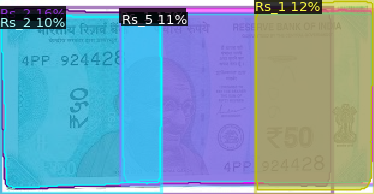

-1

In [ ]:
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import cv2
from google.colab.patches import cv2_imshow

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.1  # set a testing threshold
predictor = DefaultPredictor(cfg)

# Run inference on an image
im = cv2.imread("/content/50_rupee_note.jpeg")
outputs = predictor(im)

# Visualize the output
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])
cv2.waitKey(0)

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/output/model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.1
predictor = DefaultPredictor(cfg)

[08/29 10:16:47 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/output/model_final.pth ...


You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


WARNING [08/29 10:27:48 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/29 10:27:48 d2.data.datasets.coco]: Loaded 56 images in COCO format from /content/Currency-Note-Detection-2/valid/_annotations.coco.json


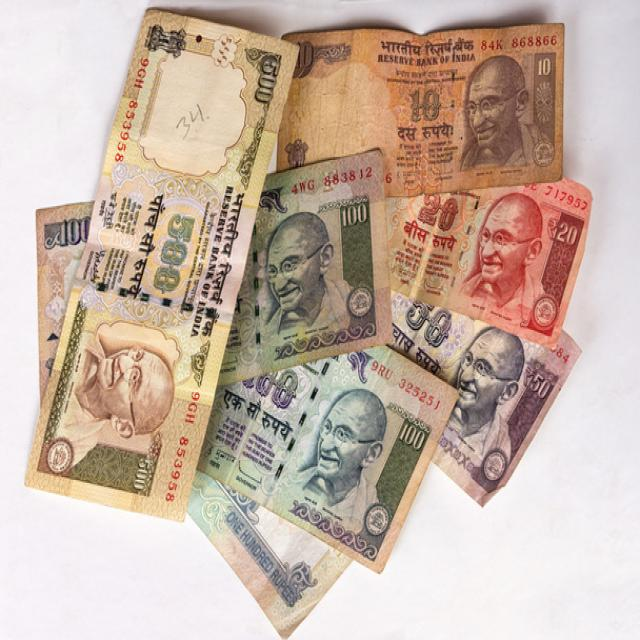

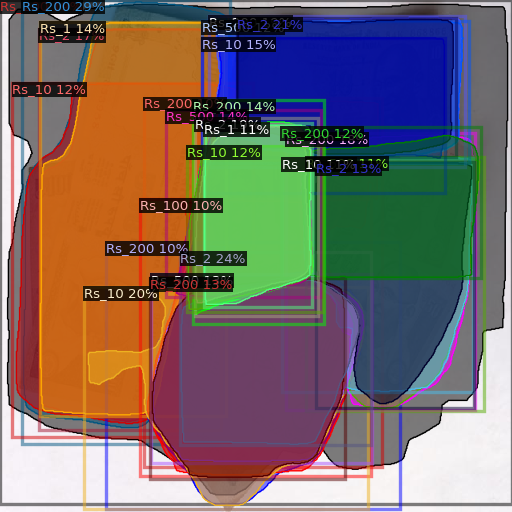

Instances(num_instances=26, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 27.4129,   0.0000, 288.0523, 555.5117],
        [225.6157, 314.5879, 463.6560, 555.9875],
        [295.7552,  22.3054, 569.9671, 195.6453],
        [105.3523, 358.8820, 459.4460, 636.2744],
        [261.3486,  20.0952, 581.4391, 208.6711],
        [243.5508, 147.9709, 397.2131, 395.4313],
        [  0.0000,   0.0000, 640.0000, 630.2372],
        [357.1419, 166.7181, 593.3173, 511.9566],
        [ 49.2240,  35.9282, 276.7563, 537.7238],
        [251.8909,  47.1870, 555.9941, 240.6655],
        [241.2956, 124.5167, 405.2153, 405.0533],
        [ 50.2634,  27.3753, 282.0769, 519.3841],
        [208.0146, 137.5036, 401.3567, 371.0632],
        [187.2063, 347.4857, 431.1834, 598.3972],
        [394.5306, 202.9519, 592.3679, 510.1842],
        [189.0365, 342.8491, 464.8069, 578.4084],
        [234.0452, 182.2808, 403.8684, 389.6519],
        [351.3028, 159.2079, 601.3176, 347.6776],
        [ 1

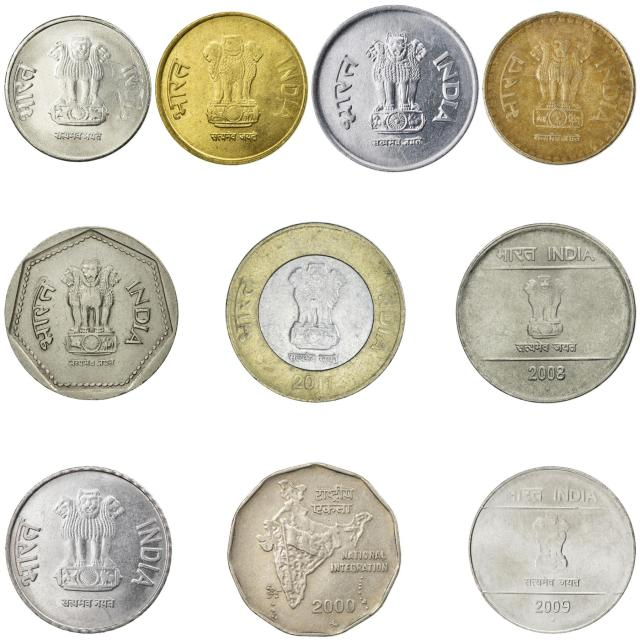

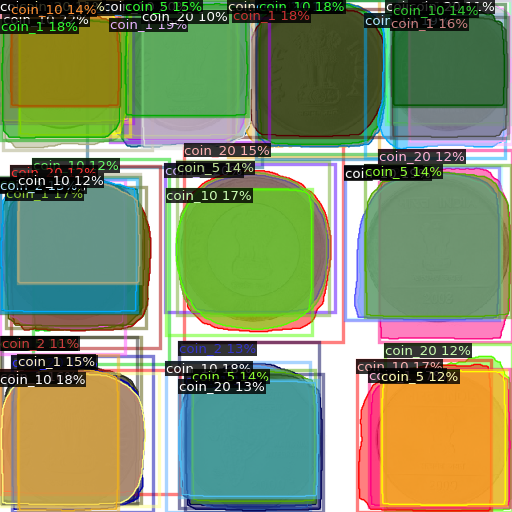

Instances(num_instances=50, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[3.6899e+00, 1.6787e+01, 1.9010e+02, 1.8752e+02],
        [1.2421e-02, 2.2551e+02, 1.5648e+02, 4.4312e+02],
        [4.3113e+02, 2.0770e+02, 6.2624e+02, 3.9879e+02],
        [2.0665e+02, 2.0540e+02, 4.1847e+02, 3.9019e+02],
        [1.2846e+02, 0.0000e+00, 2.9805e+02, 1.7103e+02],
        [4.5605e+02, 1.7572e+01, 6.3183e+02, 1.9763e+02],
        [1.3763e+02, 2.3118e+01, 3.3644e+02, 1.7731e+02],
        [4.3147e+02, 2.0902e+02, 6.2401e+02, 3.9988e+02],
        [3.2396e+02, 0.0000e+00, 4.9238e+02, 1.9295e+02],
        [0.0000e+00, 4.6604e+02, 1.9906e+02, 6.3208e+02],
        [2.9073e+02, 1.0806e+01, 4.9083e+02, 1.7135e+02],
        [1.3552e+00, 2.4765e+01, 1.5292e+02, 1.7450e+02],
        [2.0797e+02, 4.5263e+02, 3.8798e+02, 6.3999e+02],
        [2.0805e+02, 2.3594e+02, 3.9024e+02, 4.1880e+02],
        [2.3139e+02, 4.6730e+02, 4.0362e+02, 6.4000e+02],
        [4.4580e+02, 4.4998e+02, 6.1405e+

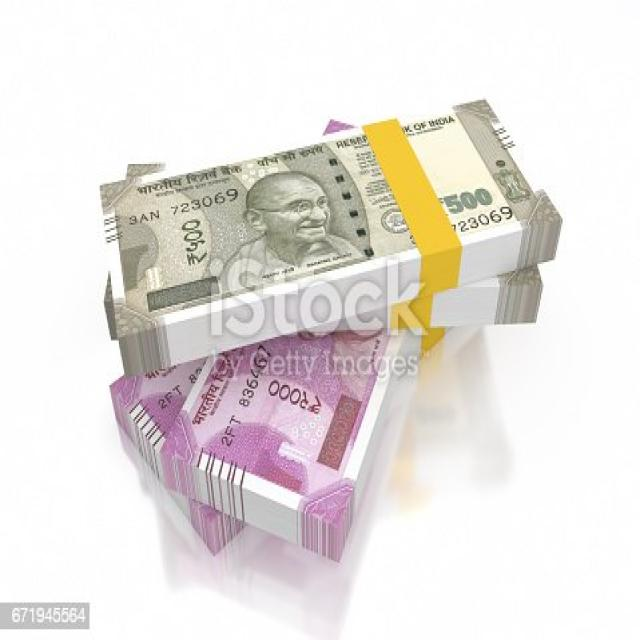

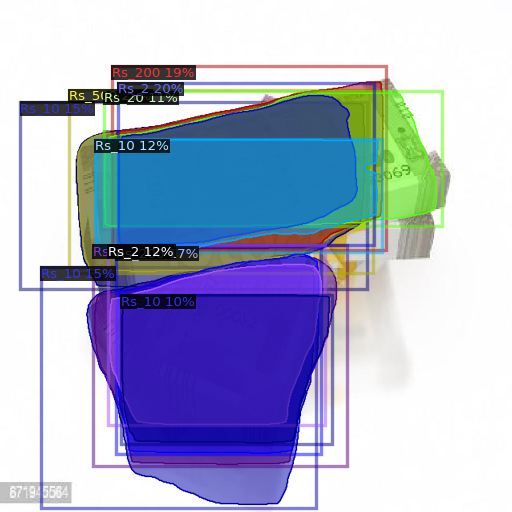

Instances(num_instances=11, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 86.7505, 111.8885, 466.1432, 341.5177],
        [147.3639, 103.1596, 467.7169, 306.6053],
        [140.2270,  82.8403, 482.0888, 312.9171],
        [144.9306, 308.8208, 401.0840, 568.0172],
        [ 25.5825, 127.0300, 458.6192, 361.3504],
        [ 51.6309, 333.9631, 394.7151, 634.6833],
        [116.3104, 305.7613, 434.2098, 582.1538],
        [134.9780, 306.0910, 406.0791, 531.6131],
        [118.4427, 174.3495, 477.0797, 315.5464],
        [130.0348, 114.3520, 552.2492, 283.0584],
        [151.1812, 368.2938, 414.5531, 554.5509]])), scores: tensor([0.2057, 0.1961, 0.1916, 0.1749, 0.1541, 0.1487, 0.1421, 0.1217, 0.1195,
        0.1114, 0.1037]), pred_classes: tensor([10,  4,  6,  6,  2,  2, 10,  4,  2,  5,  2]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, Fa

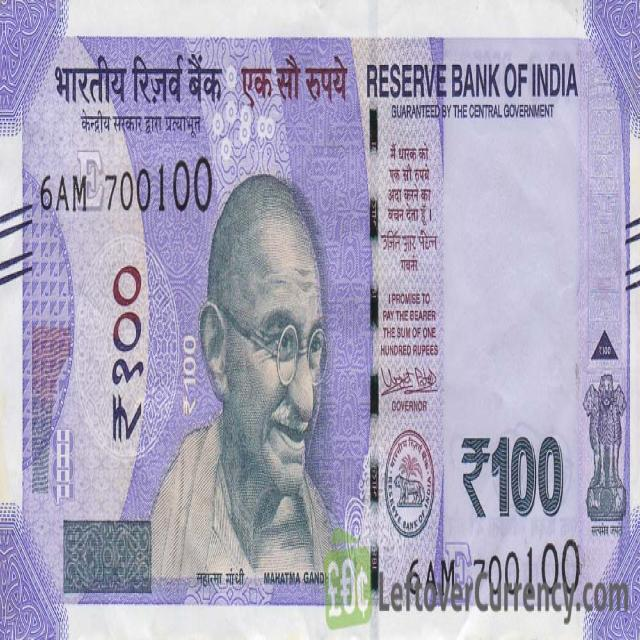

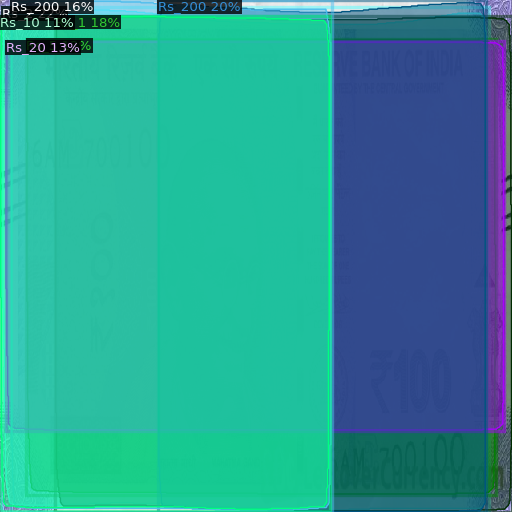

Instances(num_instances=7, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[  2.4045,   8.9583, 610.7529, 640.0000],
        [197.6590,   0.0000, 607.3058, 640.0000],
        [ 69.1657,  19.4202, 640.0000, 640.0000],
        [ 13.5665,   0.0000, 414.5352, 640.0000],
        [  7.1999,  51.6943, 630.3309, 538.1442],
        [ 33.0688,  48.4307, 619.9495, 619.2028],
        [  0.0000,  19.8213, 412.2310, 638.9688]])), scores: tensor([0.2209, 0.2023, 0.1800, 0.1552, 0.1350, 0.1160, 0.1114]), pred_classes: tensor([4, 6, 1, 6, 5, 8, 2]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],

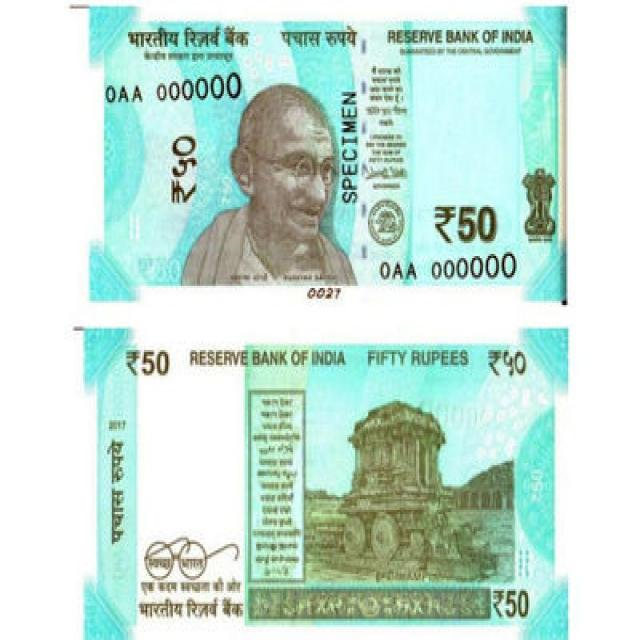

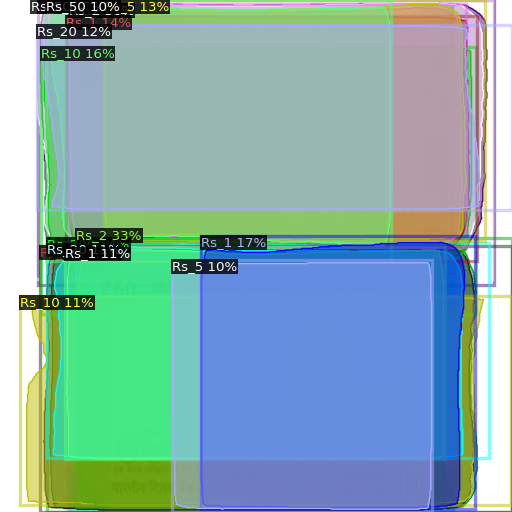

Instances(num_instances=16, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 95.2559, 285.8442, 554.6665, 633.5385],
        [ 85.6494,   4.8255, 582.1172, 308.4819],
        [250.8194, 295.3845, 593.7157, 635.6707],
        [ 50.7626,  58.5166, 594.4466, 391.9692],
        [ 59.2662, 297.5539, 640.0000, 640.0000],
        [ 82.7552,  19.9551, 596.1972, 326.1895],
        [129.9317,   0.0000, 605.6479, 301.0738],
        [ 50.2003, 307.4039, 640.0000, 640.0000],
        [ 45.7982,  31.7810, 640.0000, 262.4153],
        [ 24.9375, 369.5698, 638.3315, 631.7075],
        [ 47.5658,   0.0000, 617.2374, 355.7489],
        [ 58.3019, 304.3676, 610.6696, 573.1130],
        [ 81.5687, 309.3579, 555.6234, 574.1171],
        [ 38.3482,   0.0000, 614.5302, 348.2861],
        [214.3831, 325.3154, 539.9685, 640.0000],
        [ 57.8608,   0.0000, 488.2261, 326.4832]])), scores: tensor([0.3308, 0.2966, 0.1659, 0.1625, 0.1419, 0.1390, 0.1307, 0.1201, 0.1186,
        0.1120, 0.11

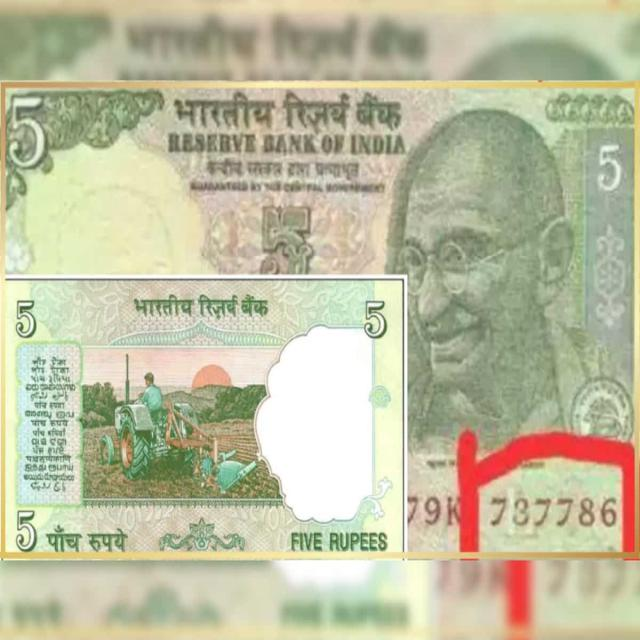

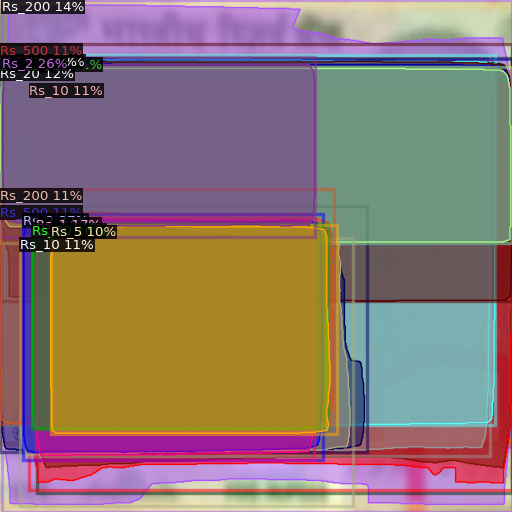

Instances(num_instances=16, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 28.3479, 267.4082, 403.6794, 575.2573],
        [  2.5338,  71.3403, 394.0897, 296.5520],
        [ 23.9679,  68.3560, 612.5370, 569.7280],
        [ 45.3726, 271.9120, 392.3261, 575.2280],
        [ 40.0929, 279.7998, 409.9884, 536.1819],
        [  2.2692,   0.0000, 640.0000, 640.0000],
        [  0.0000,  83.6583, 640.0000, 303.5839],
        [  0.0000,  74.3394, 640.0000, 303.7076],
        [ 24.8636, 297.3051, 441.1001, 632.0273],
        [  0.0000,  55.2462, 640.0000, 376.7283],
        [ 46.4929,  72.5731, 640.0000, 616.4726],
        [  0.0000, 236.1932, 417.9806, 529.4326],
        [  0.0000, 257.0911, 459.2119, 565.4819],
        [ 36.8430, 104.4796, 640.0000, 612.2751],
        [  3.5380,  69.2031, 619.0791, 531.7421],
        [ 63.1343, 281.8547, 420.7592, 542.6880]])), scores: tensor([0.3706, 0.2582, 0.2200, 0.1656, 0.1615, 0.1359, 0.1224, 0.1157, 0.1147,
        0.1120, 0.11

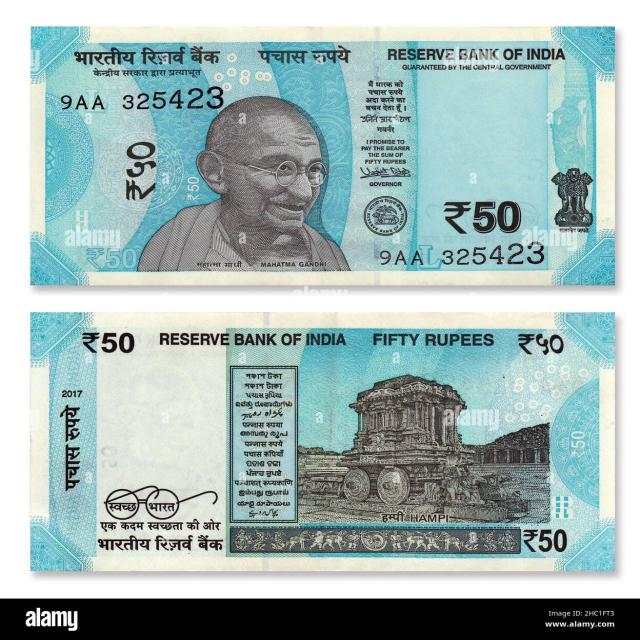

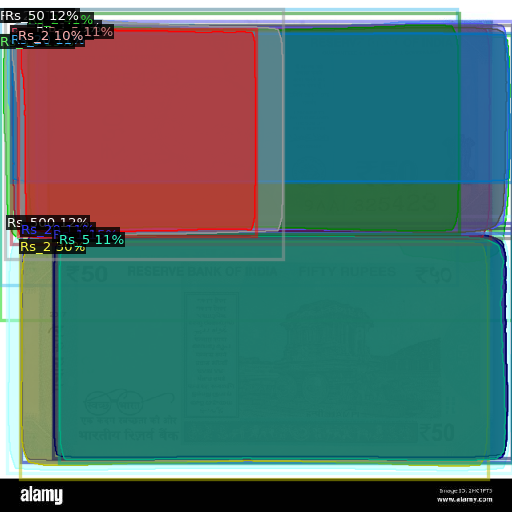

Instances(num_instances=14, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 34.4487,  15.8047, 573.9180, 292.8282],
        [ 24.6261, 300.3036, 610.3140, 598.1357],
        [  0.0000,  43.4212, 640.0000, 400.5511],
        [  0.0000,  11.3793, 571.4780, 356.7350],
        [ 66.7773, 285.2436, 640.0000, 573.0356],
        [ 45.2307,  25.9135, 640.0000, 290.8208],
        [  6.6438,  10.9210, 353.9076, 323.1727],
        [  8.9645, 269.6586, 640.0000, 591.2236],
        [ 59.5481,  31.1212, 640.0000, 297.1101],
        [ 13.1478,  40.7828, 640.0000, 227.2939],
        [ 13.9956,  32.4010, 612.6705, 305.5893],
        [ 73.2276, 291.7546, 640.0000, 578.6841],
        [ 26.2778, 278.9715, 640.0000, 577.7670],
        [ 21.9062,  36.4237, 319.5371, 294.7704]])), scores: tensor([0.4123, 0.2976, 0.1898, 0.1741, 0.1499, 0.1499, 0.1196, 0.1176, 0.1139,
        0.1119, 0.1070, 0.1066, 0.1052, 0.1041]), pred_classes: tensor([ 4,  4,  2,  5,  1,  1,  9, 10,  8,  5, 10,  8, 

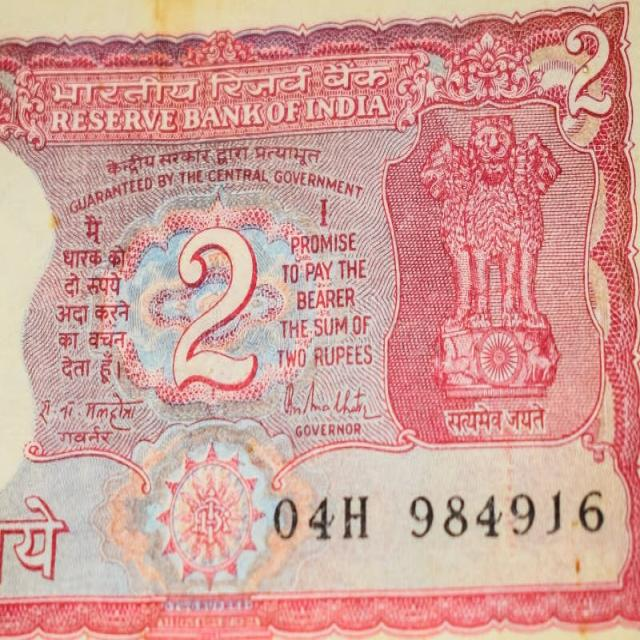

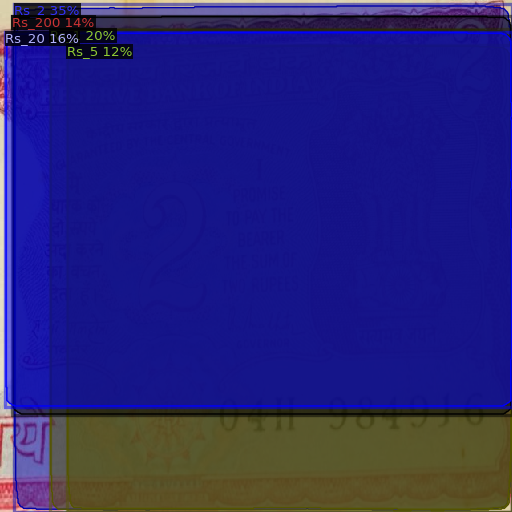

Instances(num_instances=5, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 18.1175,   5.4730, 640.0000, 640.0000],
        [ 62.9727,  36.7944, 640.0000, 640.0000],
        [  6.8095,  40.3361, 640.0000, 508.3853],
        [ 15.5307,  19.8232, 640.0000, 518.2773],
        [ 83.4583,  56.4693, 640.0000, 640.0000]])), scores: tensor([0.3496, 0.1982, 0.1584, 0.1361, 0.1192]), pred_classes: tensor([4, 1, 5, 6, 8]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
   

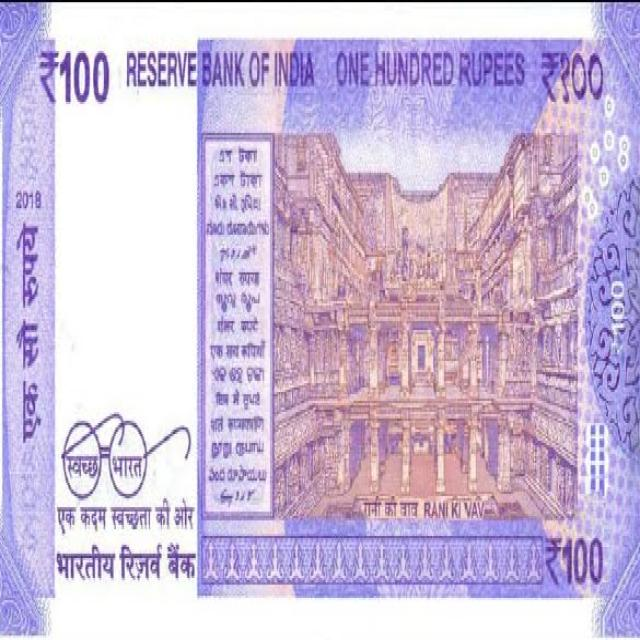

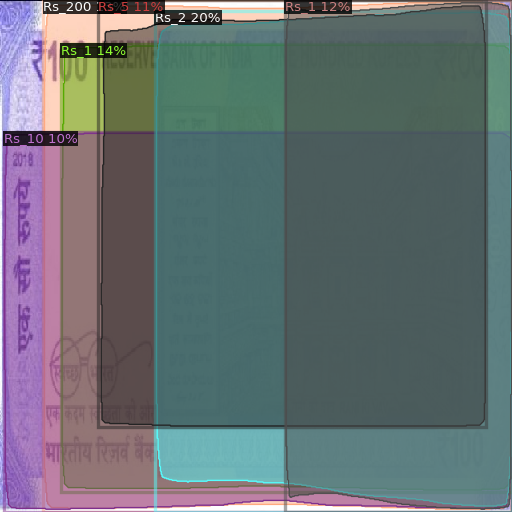

Instances(num_instances=6, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[194.2358,  13.2455, 640.0000, 640.0000],
        [ 75.9894,  55.5086, 640.0000, 614.4734],
        [ 54.3145,   0.0000, 638.7036, 640.0000],
        [356.7693,   0.0000, 640.0000, 640.0000],
        [123.0934,   0.0000, 607.4747, 533.5787],
        [  4.3774, 165.5241, 640.0000, 640.0000]])), scores: tensor([0.2042, 0.1418, 0.1302, 0.1162, 0.1092, 0.1007]), pred_classes: tensor([4, 1, 6, 1, 8, 2]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
 

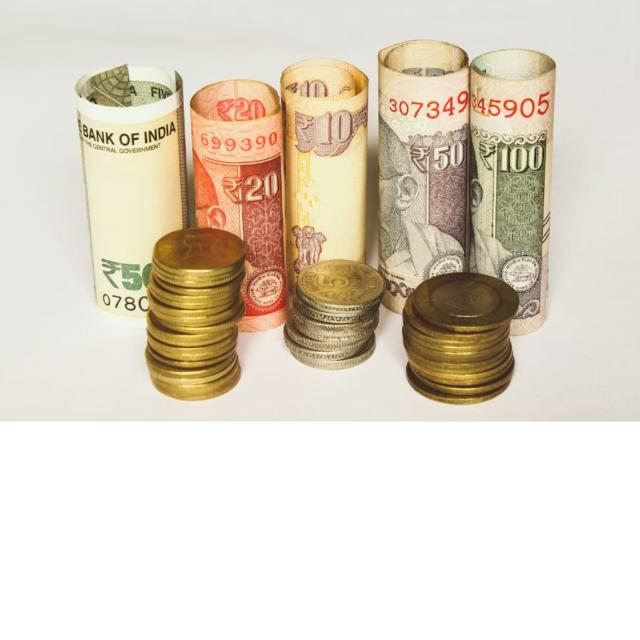

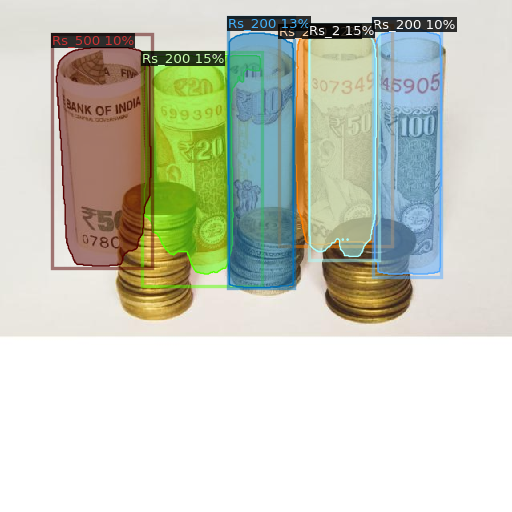

Instances(num_instances=6, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[385.6435,  30.3898, 473.9923, 325.4995],
        [177.2614,  64.6304, 327.9439, 357.6292],
        [285.0045,  21.4113, 367.6284, 360.5009],
        [348.4673,  30.7217, 490.3506, 307.6465],
        [466.6892,  22.9533, 551.8593, 345.6348],
        [ 64.6933,  42.7183, 189.7652, 335.4198]])), scores: tensor([0.1484, 0.1457, 0.1325, 0.1186, 0.1028, 0.1010]), pred_classes: tensor([ 4,  6,  6,  6,  6, 10]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, Fal

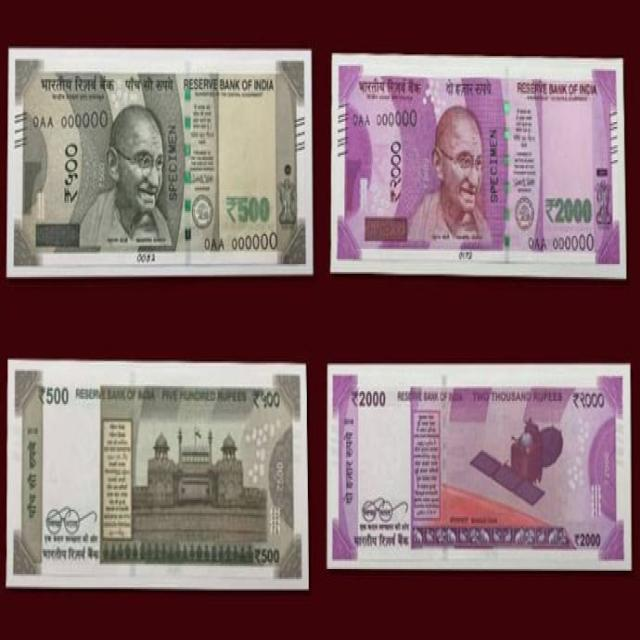

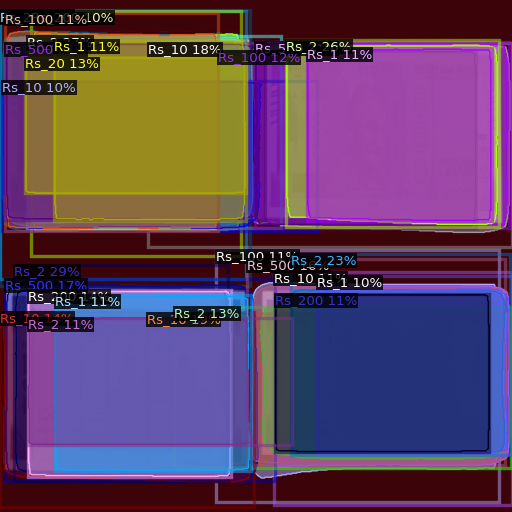

Instances(num_instances=28, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 17.6011, 331.4739, 284.7578, 601.6746],
        [ 33.9629,  45.0235, 351.6042, 284.3824],
        [357.7755,  49.7332, 623.1902, 283.9711],
        [  6.5486,  54.2123, 331.5837, 275.0241],
        [363.5218, 317.1578, 637.2821, 568.1293],
        [319.1206,  52.0797, 636.1154, 284.5550],
        [183.2237, 390.7667, 640.0000, 585.0814],
        [185.3342,  53.9735, 640.0000, 309.2037],
        [  5.7123, 349.2208, 343.5349, 601.6071],
        [309.2544, 324.2367, 631.6329, 581.3205],
        [  0.0000, 389.4685, 317.3086, 633.7484],
        [ 34.5717, 362.4599, 288.5969, 596.7467],
        [  0.0000,  12.6787, 312.7764, 357.3852],
        [ 31.4469,  71.8475, 307.5785, 241.8456],
        [218.0291, 383.2636, 638.1871, 584.9657],
        [272.0047,  63.5872, 594.8710, 284.4489],
        [ 35.1010, 397.4221, 364.7341, 556.2056],
        [383.5023,  60.4684, 614.6600, 276.5953],
        [ 6

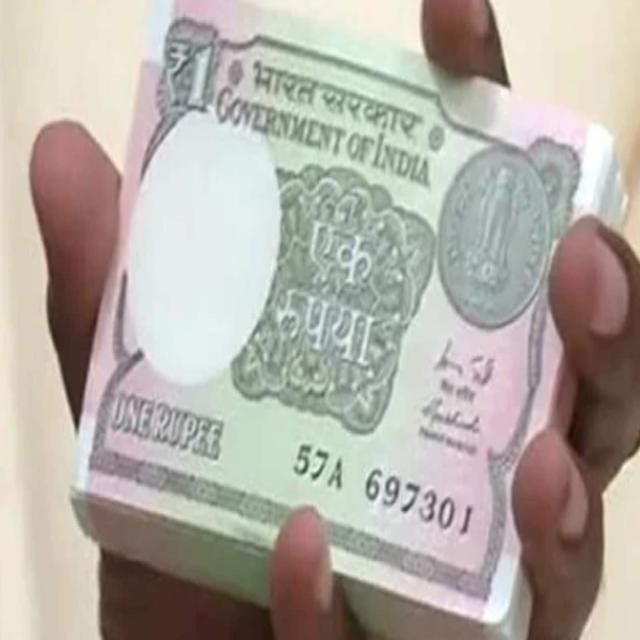

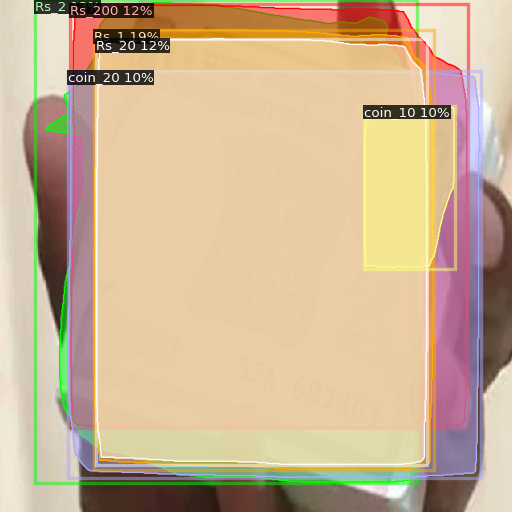

Instances(num_instances=6, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[117.0172,  37.1037, 541.9177, 587.3300],
        [ 43.3037,   0.0000, 521.0354, 603.9911],
        [ 87.7850,   4.7134, 585.6135, 535.5117],
        [119.3955,  48.4305, 533.9437, 581.5308],
        [ 84.6248,  88.4210, 601.1290, 597.5947],
        [455.0017, 131.9618, 569.0018, 336.4187]])), scores: tensor([0.1908, 0.1302, 0.1241, 0.1192, 0.1018, 0.1001]), pred_classes: tensor([ 1,  4,  6,  5, 14, 12]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, Fal

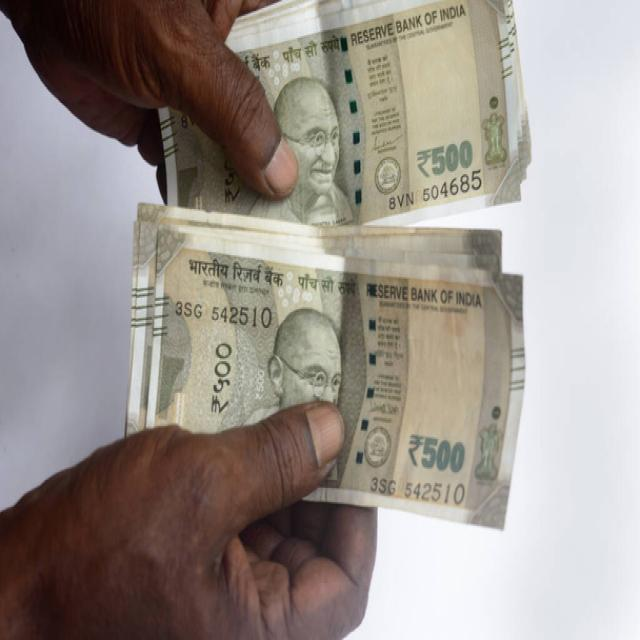

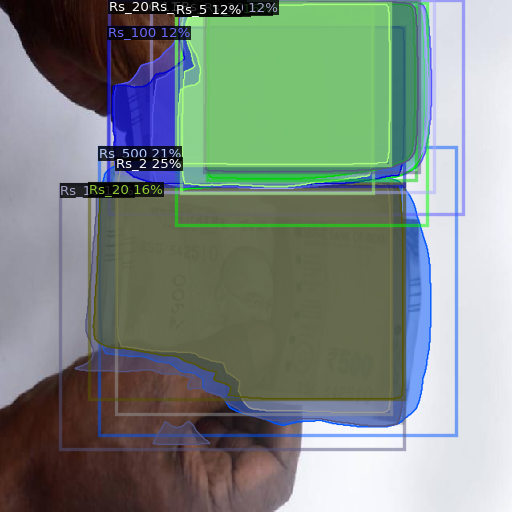

Instances(num_instances=12, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[145.4650, 196.8678, 489.0681, 517.5502],
        [188.9539,   0.0000, 542.3631, 240.2875],
        [123.2793, 183.9753, 570.2197, 543.4996],
        [258.8763,   3.0975, 519.9039, 224.8191],
        [111.4676, 228.6318, 504.3954, 499.2965],
        [220.3070,   4.3106, 533.1161, 281.1173],
        [ 75.6027, 229.7366, 504.4599, 561.0115],
        [134.7893,  33.1560, 505.5914, 232.9431],
        [220.0815,   3.6954, 487.7230, 206.0344],
        [255.6171,   1.0707, 523.7173, 214.9759],
        [225.9997,   0.0000, 466.2213, 241.2383],
        [136.6278,   0.0000, 578.3657, 267.9841]])), scores: tensor([0.2529, 0.2187, 0.2131, 0.1602, 0.1593, 0.1399, 0.1390, 0.1250, 0.1241,
        0.1217, 0.1165, 0.1082]), pred_classes: tensor([ 4, 10, 10,  4,  5,  2,  2,  3,  8,  5,  1,  6]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False,

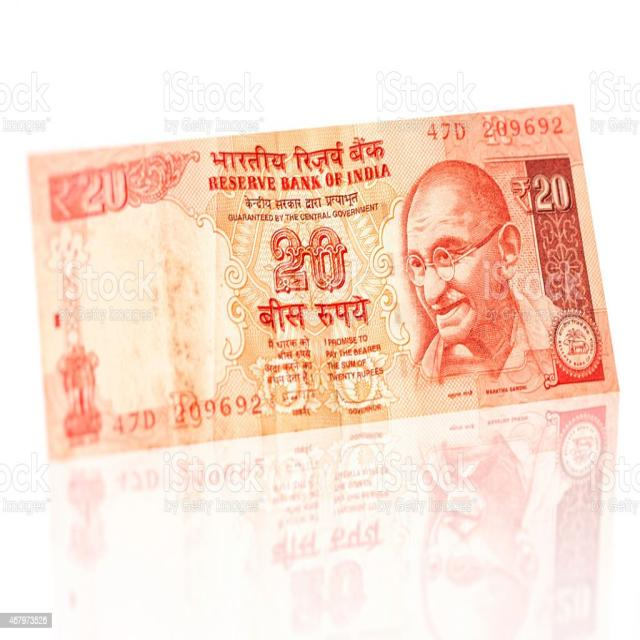

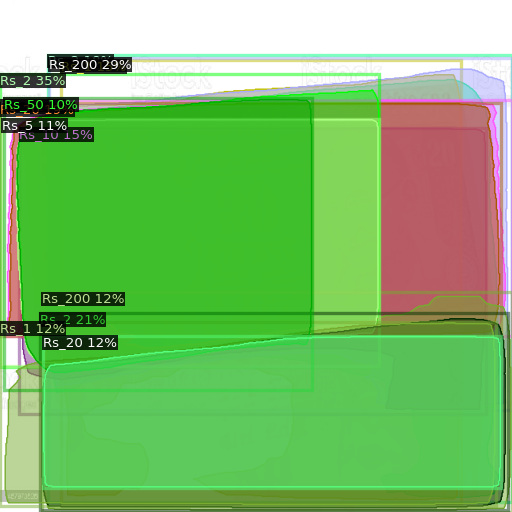

Instances(num_instances=13, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[0.0000e+00, 9.2328e+01, 4.7412e+02, 4.5887e+02],
        [6.0919e+01, 7.2000e+01, 6.4000e+02, 5.1194e+02],
        [4.9714e+01, 3.9166e+02, 6.3557e+02, 6.3798e+02],
        [1.5168e-01, 1.2864e+02, 6.2592e+02, 4.2043e+02],
        [6.0100e+01, 6.8156e+01, 6.3978e+02, 6.2762e+02],
        [7.5875e+01, 7.4711e+01, 5.7622e+02, 6.2841e+02],
        [2.4339e+01, 1.6029e+02, 6.0803e+02, 5.1688e+02],
        [0.0000e+00, 1.2509e+02, 6.4000e+02, 4.2044e+02],
        [0.0000e+00, 4.0198e+02, 6.1952e+02, 6.3237e+02],
        [5.2096e+01, 3.6562e+02, 6.4000e+02, 6.4000e+02],
        [5.3603e+01, 4.2005e+02, 6.2669e+02, 6.0951e+02],
        [2.0596e+00, 1.4854e+02, 4.7332e+02, 4.5779e+02],
        [5.2712e+00, 1.2293e+02, 3.8977e+02, 4.8775e+02]])), scores: tensor([0.3524, 0.2852, 0.2055, 0.1925, 0.1848, 0.1533, 0.1501, 0.1358, 0.1231,
        0.1196, 0.1186, 0.1072, 0.1014]), pred_classes: tensor([4,

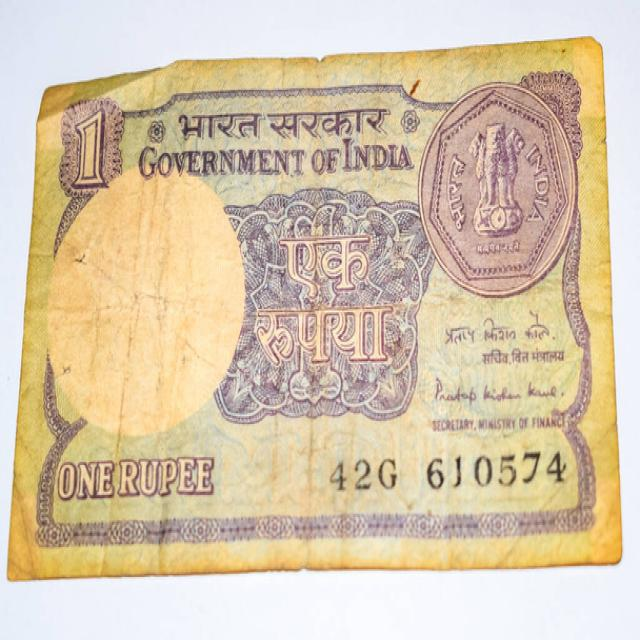

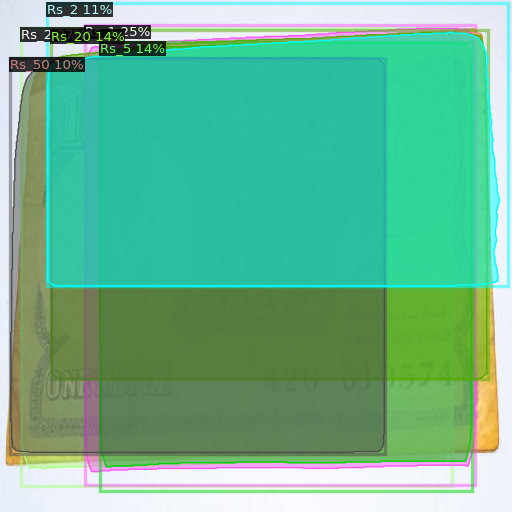

Instances(num_instances=6, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 26.3842,  35.3073, 564.7510, 607.2789],
        [105.6602,  31.8449, 594.2840, 605.9666],
        [ 63.4861,  37.5818, 609.4326, 473.9359],
        [124.4080,  52.2802, 590.3912, 614.3608],
        [ 58.9413,   3.8762, 634.6130, 357.8287],
        [ 12.4987,  72.1374, 481.4349, 566.8979]])), scores: tensor([0.2713, 0.2540, 0.1426, 0.1373, 0.1059, 0.1046]), pred_classes: tensor([4, 1, 5, 8, 4, 9]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
 

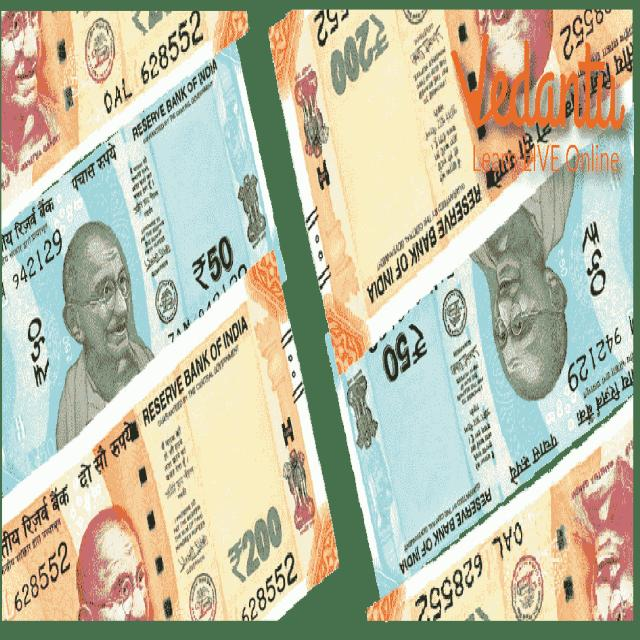

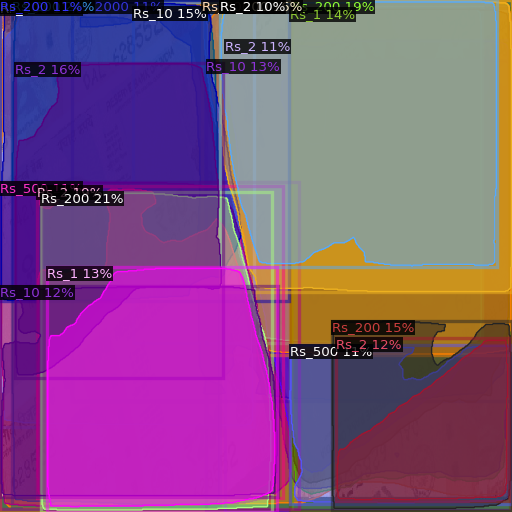

Instances(num_instances=22, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[ 14.3755,   0.0000, 274.6776, 632.5571],
        [ 50.6620, 240.0724, 339.3943, 640.0000],
        [ 45.7462, 232.7195, 353.2309, 622.4829],
        [  0.0000,   0.0000, 640.0000, 640.0000],
        [364.8255,   0.0000, 640.0000, 640.0000],
        [ 18.9171,  78.2783, 278.6038, 472.5166],
        [274.3885,   0.0000, 640.0000, 365.3412],
        [414.5782, 400.8641, 640.0000, 639.1746],
        [166.1172,   9.2475, 602.5999, 428.7637],
        [361.9424,  10.5474, 638.0013, 639.1979],
        [ 58.3781, 334.1587, 346.2020, 639.5121],
        [258.0477,  74.7434, 640.0000, 637.5141],
        [  0.0000, 357.6472, 348.0493, 620.7621],
        [420.3118, 422.2683, 635.8447, 626.4755],
        [361.9442, 430.7165, 640.0000, 629.4904],
        [  0.0000,   2.2736, 318.0433, 533.8912],
        [  0.0000,   0.0000, 360.7393, 376.2935],
        [  0.0000, 227.2202, 373.4859, 636.2857],
        [25

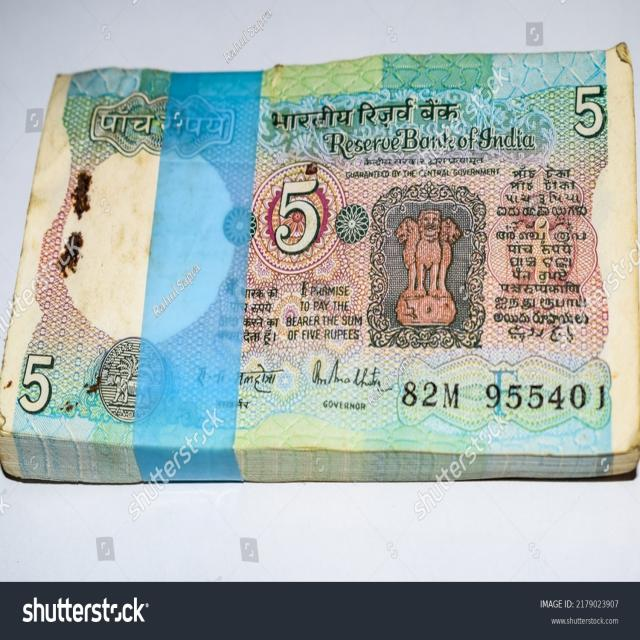

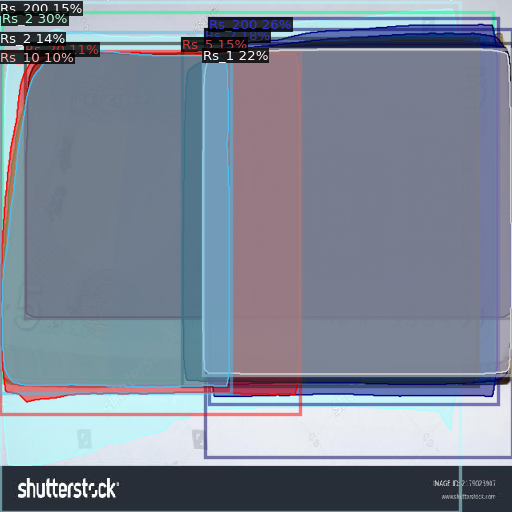

Instances(num_instances=9, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[2.8523e+00, 1.5122e+01, 6.1658e+02, 4.7737e+02],
        [2.6162e+02, 2.2954e+01, 6.2223e+02, 5.0462e+02],
        [2.5326e+02, 6.0821e+01, 6.4000e+02, 4.6863e+02],
        [2.5563e+02, 3.6772e+01, 6.4000e+02, 5.7110e+02],
        [0.0000e+00, 2.0018e+00, 5.7443e+02, 6.4000e+02],
        [2.2715e+02, 4.7875e+01, 5.9761e+02, 4.8240e+02],
        [2.6462e-01, 4.0572e+01, 2.8861e+02, 4.9105e+02],
        [3.1618e+01, 5.4098e+01, 6.4000e+02, 3.9725e+02],
        [0.0000e+00, 6.3194e+01, 3.7537e+02, 5.1787e+02]])), scores: tensor([0.2982, 0.2591, 0.2193, 0.1766, 0.1543, 0.1472, 0.1407, 0.1138, 0.1026]), pred_classes: tensor([4, 6, 1, 4, 6, 8, 4, 5, 2]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False,

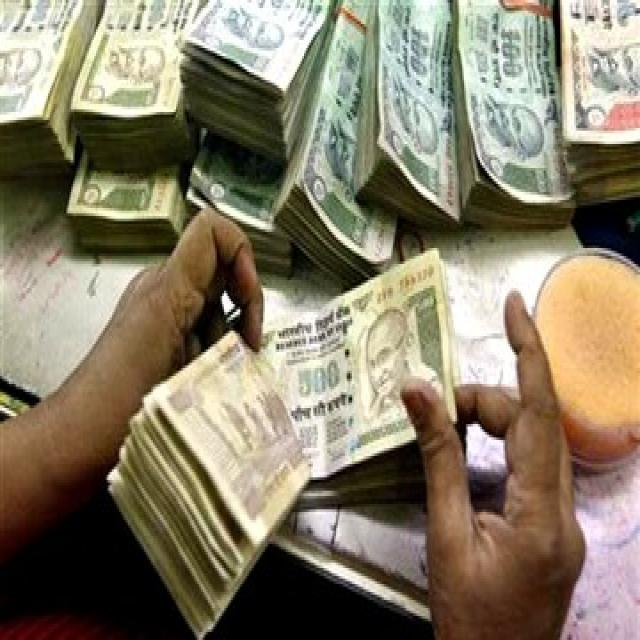

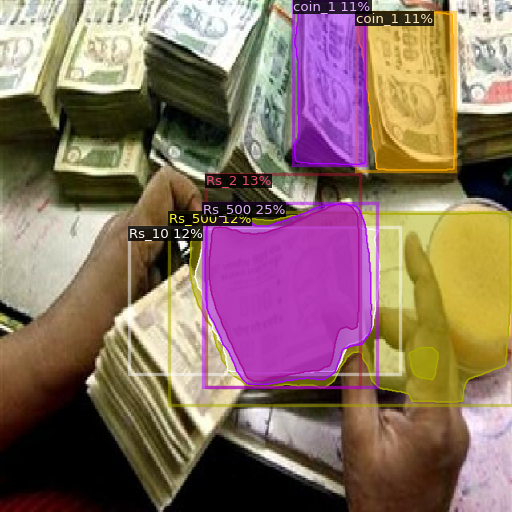

Instances(num_instances=6, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[253.9623, 253.3793, 471.3713, 484.1929],
        [257.6933, 218.0902, 450.3376, 483.8494],
        [211.4263, 265.3490, 640.0000, 506.0914],
        [160.6478, 283.8550, 500.0905, 467.4856],
        [444.6244,  14.5274, 569.2346, 214.3714],
        [366.8627,   0.0000, 457.2977, 206.1222]])), scores: tensor([0.2518, 0.1339, 0.1225, 0.1195, 0.1121, 0.1104]), pred_classes: tensor([10,  4, 10,  2, 11, 11]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, Fal

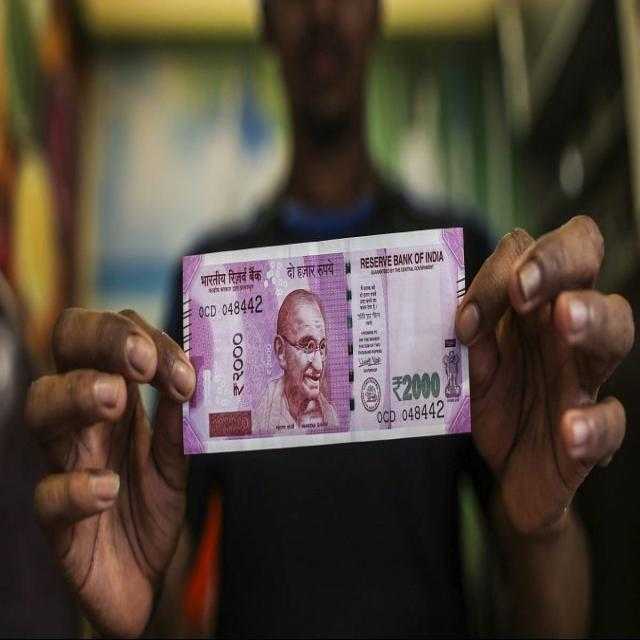

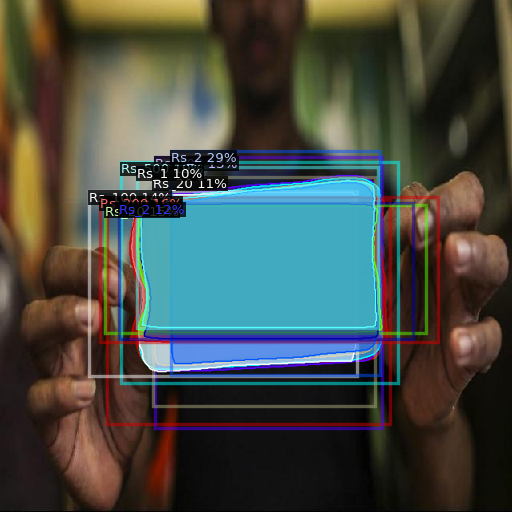

Instances(num_instances=10, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[213.3491, 188.3348, 475.0496, 468.2210],
        [151.1594, 203.1083, 497.6250, 478.2750],
        [133.9797, 249.8040, 487.7068, 529.6211],
        [125.1842, 245.8567, 547.3489, 427.7580],
        [130.9675, 255.7087, 533.1096, 415.6418],
        [110.8308, 239.1838, 445.7169, 470.1169],
        [194.2158, 196.3930, 477.0639, 534.4944],
        [149.2254, 254.0800, 516.2630, 424.0672],
        [191.4670, 221.1057, 468.9857, 506.9488],
        [171.6487, 208.5519, 472.3066, 410.1220]])), scores: tensor([0.2861, 0.1878, 0.1832, 0.1628, 0.1478, 0.1366, 0.1302, 0.1151, 0.1127,
        0.1025]), pred_classes: tensor([ 4, 10,  2,  6,  5,  3,  6,  4,  5,  1]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ...

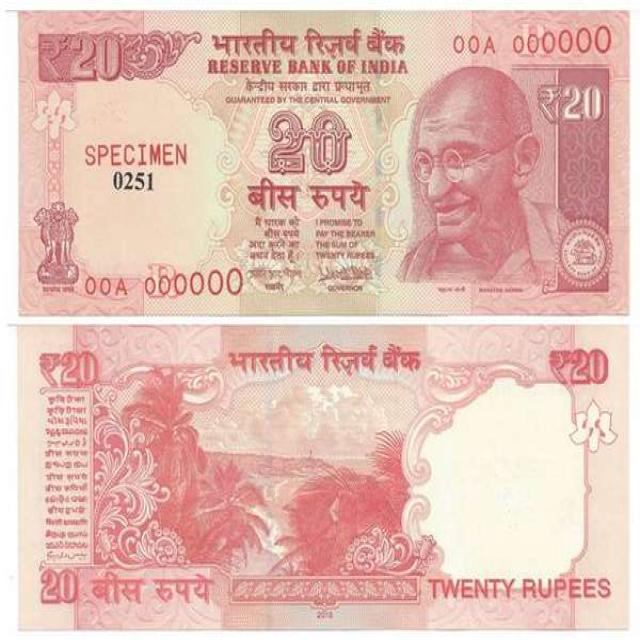

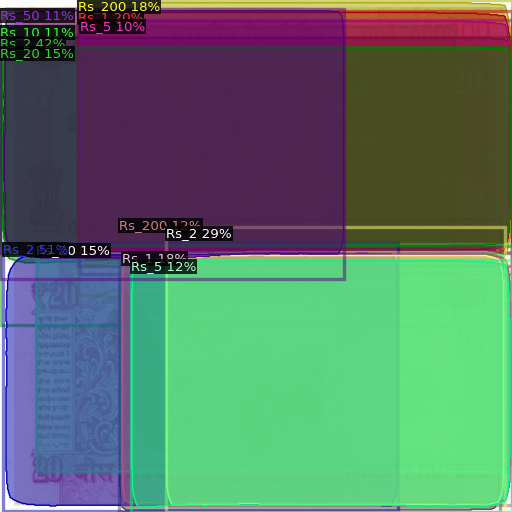

Instances(num_instances=13, image_height=640, image_width=640, fields=[pred_boxes: Boxes(tensor([[  3.8933, 304.1786, 497.3799, 639.3266],
        [  0.0000,  46.5062, 640.0000, 316.6452],
        [207.4753, 283.3646, 631.1910, 640.0000],
        [ 97.0829,  14.3629, 640.0000, 332.7842],
        [152.3367, 315.1489, 640.0000, 630.9940],
        [ 97.3881,   0.0000, 640.0000, 368.1654],
        [  0.0000,  59.2825, 640.0000, 307.9647],
        [ 45.1468, 304.8503, 640.0000, 590.4688],
        [149.1754, 273.2965, 624.6165, 640.0000],
        [163.8824, 325.0797, 640.0000, 639.9600],
        [  0.0000,  32.5698, 569.1879, 406.7967],
        [  0.0000,  11.2151, 430.4630, 349.0232],
        [100.2342,  25.3181, 640.0000, 342.5247]])), scores: tensor([0.5080, 0.4191, 0.2868, 0.1976, 0.1797, 0.1764, 0.1527, 0.1454, 0.1212,
        0.1191, 0.1145, 0.1135, 0.1014]), pred_classes: tensor([4, 4, 4, 1, 1, 6, 5, 5, 6, 8, 2, 9, 8]), pred_masks: tensor([[[False, False, False,  ..., False, False, Fa

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import ColorMode

dataset_dicts = DatasetCatalog.get("Currency_valid")
my_dataset_train_metadata = MetadataCatalog.get("Currency_valid")

for d in random.sample(dataset_dicts, 20):
    im = cv2.imread(d["file_name"])
    cv2_imshow(im)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_dataset_train_metadata,
                   scale=0.8,
    )

    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    print(outputs['instances'])


# Text-to-Speech

In [ ]:
!pip install gtts

In [ ]:
from gtts import gTTS

In [ ]:
currency_class_names = ["Nothing","Rupees 1 note","Rupees 10 note","Rupees 100 note","Rupees 2 note","Rupees 20 note",
 "Rupees 200 note","Rupees 2000 note","Rupees 5 note","Rupees 50 note","Rupees 500 note","Coin of 1 rupee",
 "Coin of 10 rupees","Coin of 2 rupees","Coin of 20 rupees","Coin of 5 rupees","Coin of 50 paisa"]

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/output/model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.15
predictor = DefaultPredictor(cfg)

[08/29 10:41:55 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/output/model_final.pth ...


WARNING [08/29 10:50:07 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/29 10:50:07 d2.data.datasets.coco]: Loaded 56 images in COCO format from /content/Currency-Note-Detection-2/valid/_annotations.coco.json


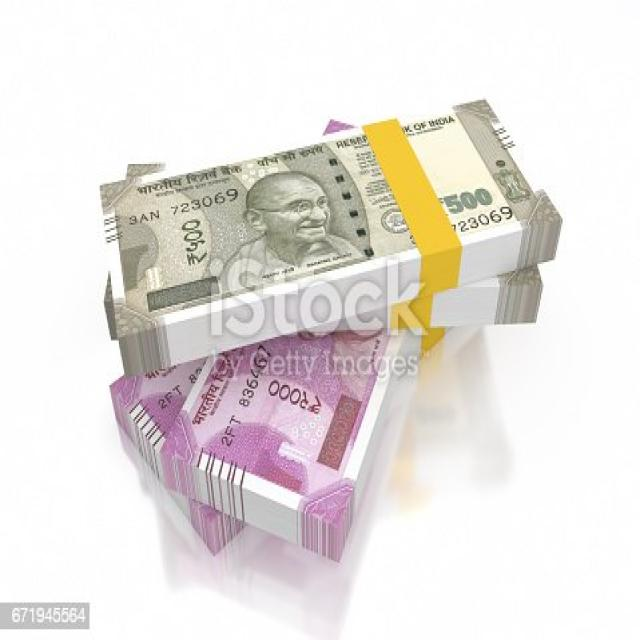

Detected: Rupees 500 note with probability: 0.21
Detected: Rupees 2 note with probability: 0.20
Detected: Rupees 200 note with probability: 0.19
Detected: Rupees 200 note with probability: 0.17
Detected: Rupees 10 note with probability: 0.15


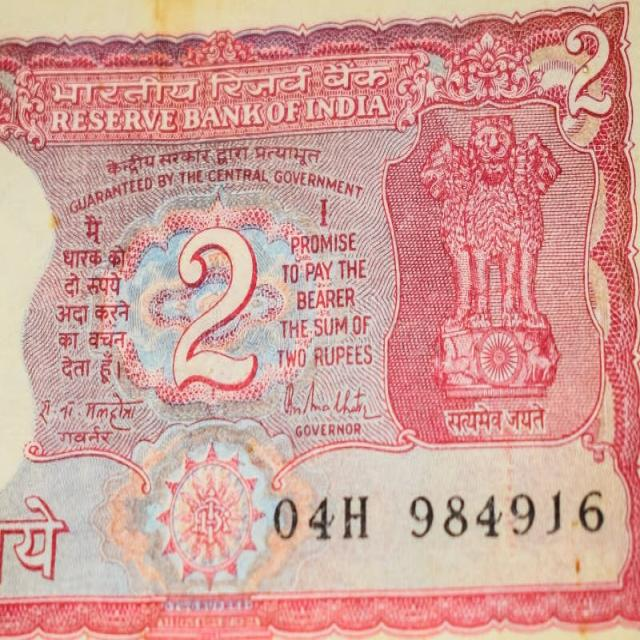

Detected: Rupees 2 note with probability: 0.35
Detected: Rupees 1 note with probability: 0.20
Detected: Rupees 20 note with probability: 0.16


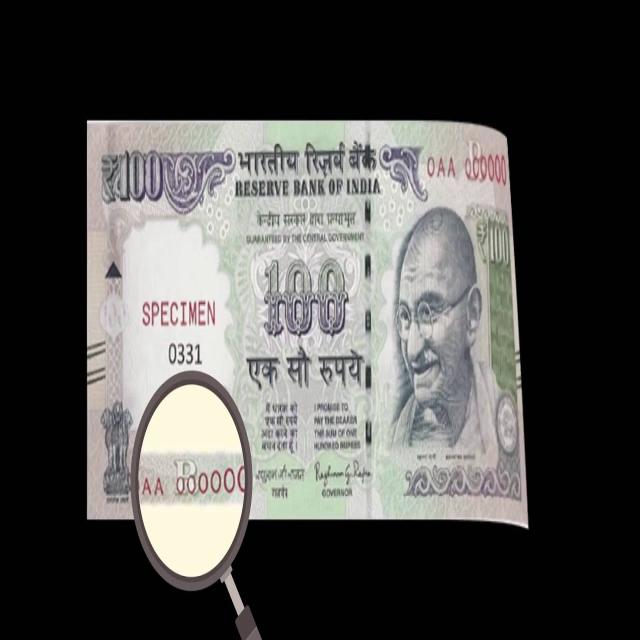

Detected: Rupees 2 note with probability: 0.28
Detected: Rupees 1 note with probability: 0.26
Detected: Rupees 200 note with probability: 0.19


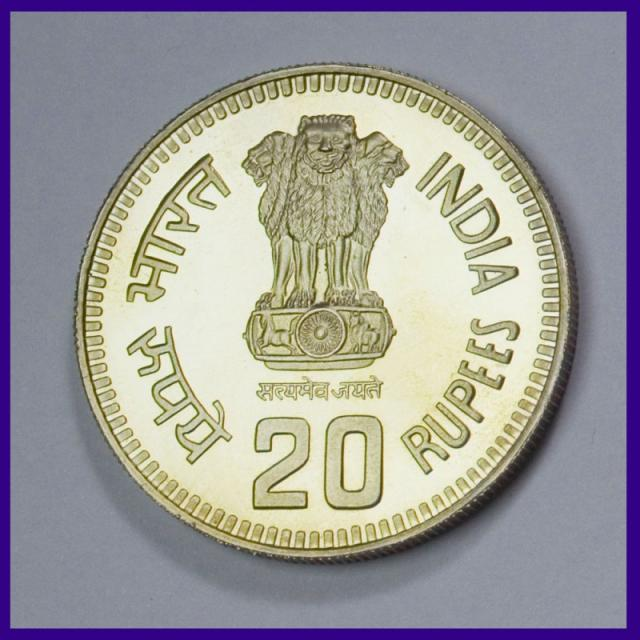

Detected: Coin of 20 rupees with probability: 0.19


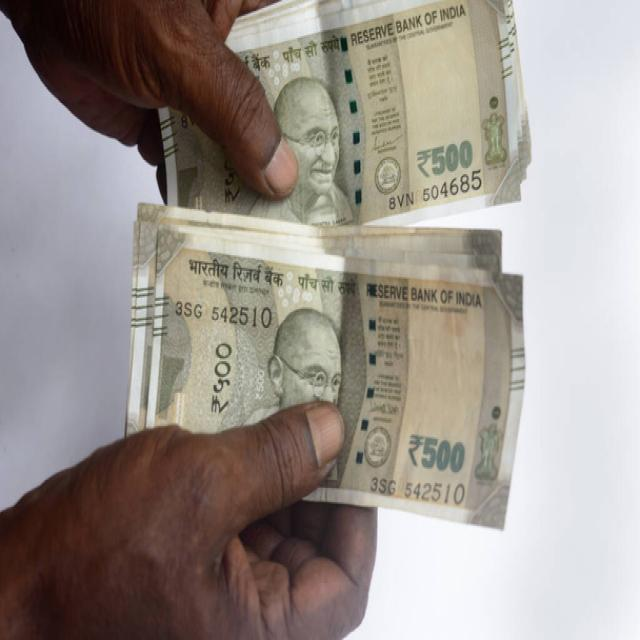

Detected: Rupees 2 note with probability: 0.25
Detected: Rupees 500 note with probability: 0.22
Detected: Rupees 500 note with probability: 0.21
Detected: Rupees 2 note with probability: 0.16
Detected: Rupees 20 note with probability: 0.16


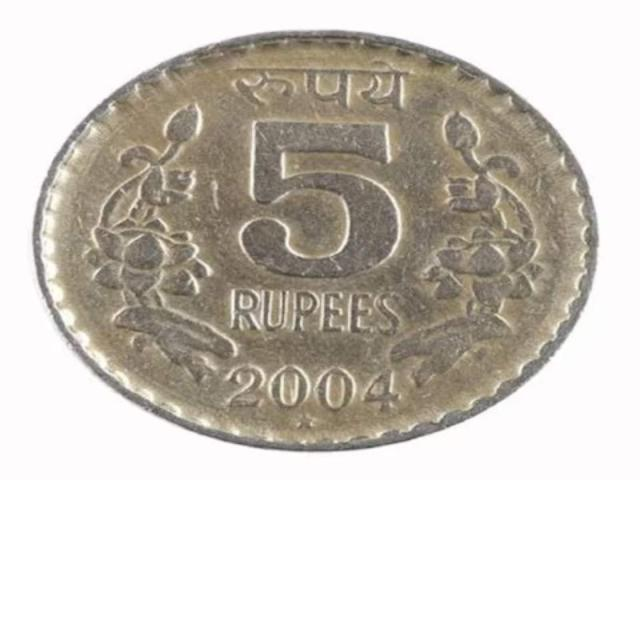

Detected: Coin of 20 rupees with probability: 0.17
Detected: Rupees 1 note with probability: 0.15


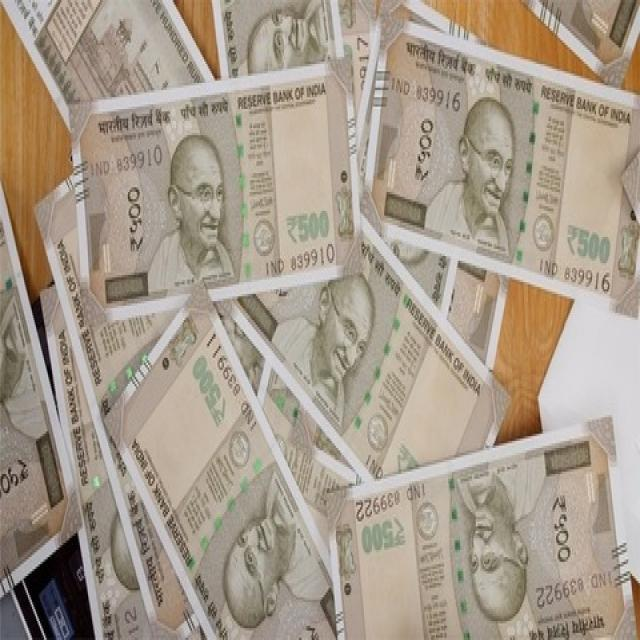

Detected: Rupees 2 note with probability: 0.31
Detected: Rupees 2 note with probability: 0.24
Detected: Rupees 200 note with probability: 0.23
Detected: Rupees 10 note with probability: 0.23
Detected: Rupees 10 note with probability: 0.23
Detected: Rupees 500 note with probability: 0.22
Detected: Rupees 500 note with probability: 0.21
Detected: Rupees 2 note with probability: 0.21
Detected: Rupees 10 note with probability: 0.16
Detected: Rupees 500 note with probability: 0.16


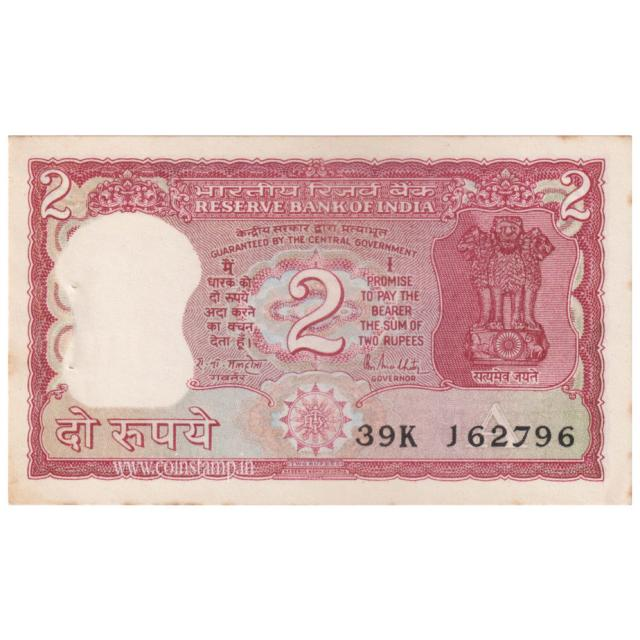

Detected: Rupees 2 note with probability: 0.38
Detected: Rupees 2 note with probability: 0.23
Detected: Rupees 20 note with probability: 0.16
Detected: Rupees 1 note with probability: 0.16
Detected: Rupees 200 note with probability: 0.15


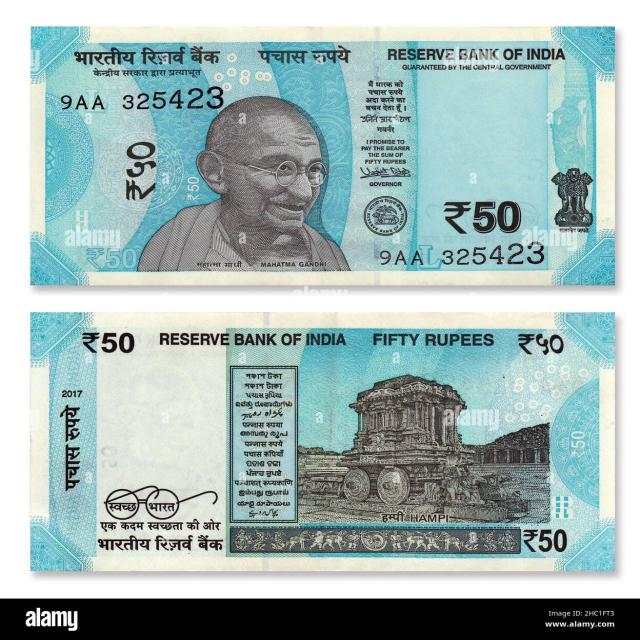

Detected: Rupees 2 note with probability: 0.41
Detected: Rupees 2 note with probability: 0.30
Detected: Rupees 10 note with probability: 0.19
Detected: Rupees 20 note with probability: 0.17


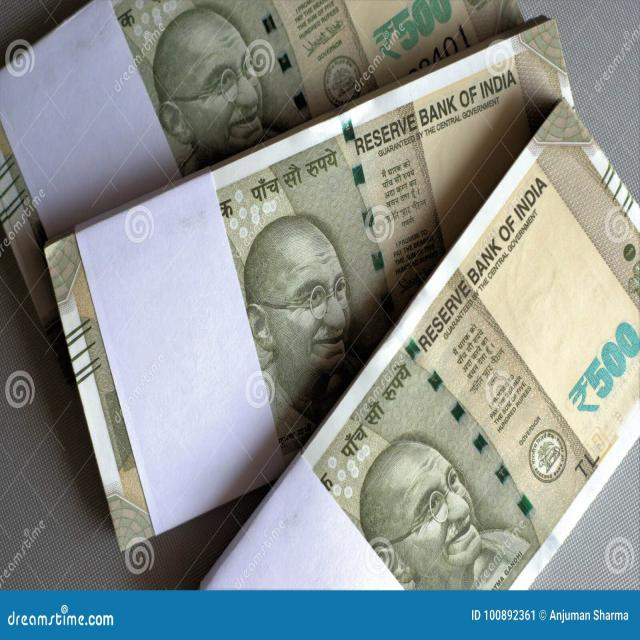

Detected: Rupees 200 note with probability: 0.21
Detected: Rupees 500 note with probability: 0.18
Detected: Rupees 500 note with probability: 0.17
Detected: Rupees 200 note with probability: 0.17


In [ ]:
dataset_dicts = DatasetCatalog.get("Currency_valid")
my_dataset_train_metadata = MetadataCatalog.get("Currency_valid")
n = 0;
for d in random.sample(dataset_dicts, 10):
    im = cv2.imread(d["file_name"])
    cv2_imshow(im)
    outputs = predictor(im)
    classes = outputs["instances"].pred_classes.cpu().tolist()
    scores = outputs["instances"].scores.cpu().tolist()
    for class_id, score in zip(classes, scores):
        class_name = currency_class_names[class_id]
        print(f"Detected: {class_name} with probability: {score:.2f}")
        text_ = f"Detected {class_name} with a probability of {score:.2f}"
        tts = gTTS(text=text_, lang='en')
        path = f"output_speech{n}.mp3"
        tts.save(path)
        os.system(path)
        n+=1

